# Deepfake Face Generation using Deep Convolutional Generative Adversarial Networks (DCGAN)

## Dataset preparation

Dataset used: CelebFaces Attributes (CelebA) Dataset (Link to download: [Kaggle](https://www.kaggle.com/jessicali9530/celeba-dataset))

For this implementation, I have moved images into folders each containing 1000 images.

To do so, uncomment the following cell and run it. You need to do this only once.

In [ ]:
# import shutil
# import os

# source_dir = 'archive/img_align_celeba/img_align_celeba'

# onlyfiles = [f for f in os.listdir(source_dir)]
# print(len(onlyfiles))

# subdir_name = 1
# target_dir = os.path.join(source_dir, str(subdir_name)) 

# for i in range(len(onlyfiles)):
    
#     if i%1000 == 0:
#         target_dir = os.path.join(source_dir, str(subdir_name))
#         os.makedirs(target_dir)
#         subdir_name = subdir_name + 1
    
#     shutil.move(os.path.join(source_dir, onlyfiles[i]), target_dir)

## Import Libraries

In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


## Set variables and hyperparameters

In [3]:
# Root directory for dataset
dataroot = "archive/img_align_celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 20

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

## Data augmentation and creating dataloader

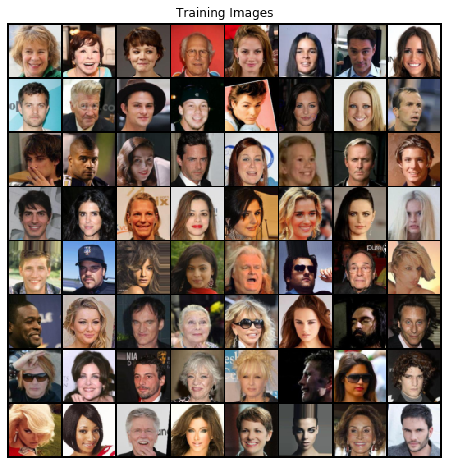

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Custom weights initialization

In [5]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator code

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator code

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Training 

In [11]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            torch.save(netG.state_dict(), 'models/dcgan_pytorch_netG_20.pth')
            torch.save(netD.state_dict(), 'models/dcgan_pytorch_netD_20.pth')
            torch.save(optimizerG.state_dict(), 'models/dcgan_pytorch_optimizerG_20.pth')
            torch.save(optimizerD.state_dict(), 'models/dcgan_pytorch_optimizerD_20.pth')

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/20][0/1583]	Loss_D: 1.4741	Loss_G: 5.1380	D(x): 0.5428	D(G(z)): 0.4753 / 0.0095
[0/20][50/1583]	Loss_D: 0.2785	Loss_G: 10.3989	D(x): 0.9071	D(G(z)): 0.0122 / 0.0001
[0/20][100/1583]	Loss_D: 0.6225	Loss_G: 5.9967	D(x): 0.8366	D(G(z)): 0.0991 / 0.0270
[0/20][150/1583]	Loss_D: 0.3597	Loss_G: 3.3103	D(x): 0.8159	D(G(z)): 0.0521 / 0.0772
[0/20][200/1583]	Loss_D: 0.4958	Loss_G: 4.3726	D(x): 0.7336	D(G(z)): 0.0573 / 0.0291
[0/20][250/1583]	Loss_D: 0.8642	Loss_G: 6.5271	D(x): 0.5718	D(G(z)): 0.0122 / 0.0044
[0/20][300/1583]	Loss_D: 0.4181	Loss_G: 3.4953	D(x): 0.7914	D(G(z)): 0.1149 / 0.0409
[0/20][350/1583]	Loss_D: 0.9012	Loss_G: 3.0121	D(x): 0.5361	D(G(z)): 0.0316 / 0.0785
[0/20][400/1583]	Loss_D: 0.7108	Loss_G: 8.2224	D(x): 0.9630	D(G(z)): 0.4171 / 0.0008
[0/20][450/1583]	Loss_D: 0.4019	Loss_G: 4.9980	D(x): 0.9065	D(G(z)): 0.2235 / 0.0141
[0/20][500/1583]	Loss_D: 0.6123	Loss_G: 3.6340	D(x): 0.7248	D(G(z)): 0.1304 / 0.0431
[0/20][550/1583]	Loss_D: 1.2303	Loss_G: 8

[3/20][0/1583]	Loss_D: 0.5308	Loss_G: 2.6454	D(x): 0.7825	D(G(z)): 0.2052 / 0.0972
[3/20][50/1583]	Loss_D: 0.4769	Loss_G: 2.8948	D(x): 0.8630	D(G(z)): 0.2381 / 0.0736
[3/20][100/1583]	Loss_D: 0.4869	Loss_G: 2.1277	D(x): 0.7787	D(G(z)): 0.1796 / 0.1511
[3/20][150/1583]	Loss_D: 0.7183	Loss_G: 3.3903	D(x): 0.7993	D(G(z)): 0.3457 / 0.0469
[3/20][200/1583]	Loss_D: 1.1750	Loss_G: 0.8330	D(x): 0.3833	D(G(z)): 0.0233 / 0.4873
[3/20][250/1583]	Loss_D: 0.6842	Loss_G: 1.7509	D(x): 0.6497	D(G(z)): 0.1594 / 0.2094
[3/20][300/1583]	Loss_D: 0.7233	Loss_G: 0.8983	D(x): 0.6105	D(G(z)): 0.1407 / 0.4547
[3/20][350/1583]	Loss_D: 2.6977	Loss_G: 5.7285	D(x): 0.9831	D(G(z)): 0.8634 / 0.0065
[3/20][400/1583]	Loss_D: 0.5775	Loss_G: 2.6205	D(x): 0.8351	D(G(z)): 0.2900 / 0.0922
[3/20][450/1583]	Loss_D: 0.8065	Loss_G: 1.7702	D(x): 0.5201	D(G(z)): 0.0309 / 0.2164
[3/20][500/1583]	Loss_D: 0.5872	Loss_G: 3.4961	D(x): 0.9172	D(G(z)): 0.3621 / 0.0388
[3/20][550/1583]	Loss_D: 0.6129	Loss_G: 2.5360	D(x): 0.7731	D(G(z)):

[6/20][50/1583]	Loss_D: 0.4157	Loss_G: 2.4132	D(x): 0.7925	D(G(z)): 0.1438 / 0.1107
[6/20][100/1583]	Loss_D: 0.6815	Loss_G: 2.6269	D(x): 0.8715	D(G(z)): 0.3766 / 0.1015
[6/20][150/1583]	Loss_D: 0.7113	Loss_G: 2.7493	D(x): 0.7392	D(G(z)): 0.2785 / 0.0863
[6/20][200/1583]	Loss_D: 0.4717	Loss_G: 2.0498	D(x): 0.7618	D(G(z)): 0.1469 / 0.1636
[6/20][250/1583]	Loss_D: 0.3150	Loss_G: 2.6871	D(x): 0.8238	D(G(z)): 0.0932 / 0.0912
[6/20][300/1583]	Loss_D: 0.3564	Loss_G: 3.6596	D(x): 0.8544	D(G(z)): 0.1568 / 0.0400
[6/20][350/1583]	Loss_D: 0.7044	Loss_G: 2.6232	D(x): 0.8148	D(G(z)): 0.3494 / 0.1010
[6/20][400/1583]	Loss_D: 0.3587	Loss_G: 2.5433	D(x): 0.8055	D(G(z)): 0.1082 / 0.1028
[6/20][450/1583]	Loss_D: 0.6172	Loss_G: 1.1663	D(x): 0.6403	D(G(z)): 0.0834 / 0.3556
[6/20][500/1583]	Loss_D: 0.6744	Loss_G: 4.7788	D(x): 0.9340	D(G(z)): 0.4010 / 0.0128
[6/20][550/1583]	Loss_D: 0.5556	Loss_G: 1.7313	D(x): 0.6756	D(G(z)): 0.1057 / 0.2214
[6/20][600/1583]	Loss_D: 0.5414	Loss_G: 1.9474	D(x): 0.7246	D(G(z)

[9/20][100/1583]	Loss_D: 0.5876	Loss_G: 3.9480	D(x): 0.9610	D(G(z)): 0.3739 / 0.0304
[9/20][150/1583]	Loss_D: 0.3354	Loss_G: 2.1408	D(x): 0.7977	D(G(z)): 0.0817 / 0.1614
[9/20][200/1583]	Loss_D: 0.6893	Loss_G: 4.9417	D(x): 0.9211	D(G(z)): 0.4068 / 0.0097
[9/20][250/1583]	Loss_D: 0.3563	Loss_G: 3.3906	D(x): 0.8916	D(G(z)): 0.1927 / 0.0458
[9/20][300/1583]	Loss_D: 0.4033	Loss_G: 4.4398	D(x): 0.9441	D(G(z)): 0.2578 / 0.0172
[9/20][350/1583]	Loss_D: 0.3103	Loss_G: 2.5866	D(x): 0.8346	D(G(z)): 0.1031 / 0.1002
[9/20][400/1583]	Loss_D: 0.8781	Loss_G: 4.3420	D(x): 0.8774	D(G(z)): 0.4532 / 0.0198
[9/20][450/1583]	Loss_D: 1.0359	Loss_G: 1.0838	D(x): 0.4254	D(G(z)): 0.0217 / 0.4084
[9/20][500/1583]	Loss_D: 0.3501	Loss_G: 2.9551	D(x): 0.9029	D(G(z)): 0.1928 / 0.0687
[9/20][550/1583]	Loss_D: 0.4199	Loss_G: 3.1094	D(x): 0.9068	D(G(z)): 0.2368 / 0.0639
[9/20][600/1583]	Loss_D: 0.3369	Loss_G: 2.2096	D(x): 0.7969	D(G(z)): 0.0766 / 0.1546
[9/20][650/1583]	Loss_D: 0.7633	Loss_G: 5.5569	D(x): 0.9595	D(G(z

[12/20][100/1583]	Loss_D: 1.7462	Loss_G: 0.7379	D(x): 0.3217	D(G(z)): 0.1462 / 0.5751
[12/20][150/1583]	Loss_D: 0.4678	Loss_G: 5.1475	D(x): 0.9734	D(G(z)): 0.3082 / 0.0096
[12/20][200/1583]	Loss_D: 0.2312	Loss_G: 2.4980	D(x): 0.8810	D(G(z)): 0.0818 / 0.1196
[12/20][250/1583]	Loss_D: 0.3472	Loss_G: 5.9607	D(x): 0.9706	D(G(z)): 0.2421 / 0.0042
[12/20][300/1583]	Loss_D: 0.2327	Loss_G: 3.8087	D(x): 0.9353	D(G(z)): 0.1323 / 0.0362
[12/20][350/1583]	Loss_D: 1.7141	Loss_G: 0.8627	D(x): 0.2583	D(G(z)): 0.0170 / 0.4832
[12/20][400/1583]	Loss_D: 0.4038	Loss_G: 2.1383	D(x): 0.7326	D(G(z)): 0.0326 / 0.1692
[12/20][450/1583]	Loss_D: 0.1866	Loss_G: 3.3914	D(x): 0.8885	D(G(z)): 0.0565 / 0.0515
[12/20][500/1583]	Loss_D: 0.1414	Loss_G: 3.3900	D(x): 0.9134	D(G(z)): 0.0426 / 0.0534
[12/20][550/1583]	Loss_D: 0.9800	Loss_G: 1.1865	D(x): 0.5933	D(G(z)): 0.2662 / 0.3760
[12/20][600/1583]	Loss_D: 0.2467	Loss_G: 4.4506	D(x): 0.9501	D(G(z)): 0.1608 / 0.0169
[12/20][650/1583]	Loss_D: 0.7236	Loss_G: 1.9373	D(x): 

[15/20][50/1583]	Loss_D: 0.5930	Loss_G: 8.0893	D(x): 0.9956	D(G(z)): 0.3765 / 0.0005
[15/20][100/1583]	Loss_D: 0.3723	Loss_G: 7.2166	D(x): 0.9884	D(G(z)): 0.2570 / 0.0011
[15/20][150/1583]	Loss_D: 0.1882	Loss_G: 3.3010	D(x): 0.9123	D(G(z)): 0.0807 / 0.0575
[15/20][200/1583]	Loss_D: 0.1463	Loss_G: 3.8021	D(x): 0.9408	D(G(z)): 0.0722 / 0.0358
[15/20][250/1583]	Loss_D: 0.1114	Loss_G: 3.4597	D(x): 0.9317	D(G(z)): 0.0354 / 0.0522
[15/20][300/1583]	Loss_D: 0.1903	Loss_G: 3.3743	D(x): 0.8650	D(G(z)): 0.0281 / 0.0611
[15/20][350/1583]	Loss_D: 0.1074	Loss_G: 3.6242	D(x): 0.9358	D(G(z)): 0.0297 / 0.0429
[15/20][400/1583]	Loss_D: 1.1593	Loss_G: 2.2136	D(x): 0.6812	D(G(z)): 0.4340 / 0.1705
[15/20][450/1583]	Loss_D: 0.3322	Loss_G: 2.0089	D(x): 0.7831	D(G(z)): 0.0303 / 0.2084
[15/20][500/1583]	Loss_D: 0.2542	Loss_G: 4.2767	D(x): 0.9254	D(G(z)): 0.1445 / 0.0218
[15/20][550/1583]	Loss_D: 0.2294	Loss_G: 2.9279	D(x): 0.8297	D(G(z)): 0.0247 / 0.0896
[15/20][600/1583]	Loss_D: 0.1026	Loss_G: 4.0059	D(x): 0

[18/20][0/1583]	Loss_D: 0.5822	Loss_G: 2.8121	D(x): 0.7886	D(G(z)): 0.2346 / 0.0940
[18/20][50/1583]	Loss_D: 0.1707	Loss_G: 2.8076	D(x): 0.8842	D(G(z)): 0.0322 / 0.1043
[18/20][100/1583]	Loss_D: 0.1524	Loss_G: 3.6970	D(x): 0.9043	D(G(z)): 0.0371 / 0.0462
[18/20][150/1583]	Loss_D: 0.4041	Loss_G: 1.1235	D(x): 0.7366	D(G(z)): 0.0430 / 0.4297
[18/20][200/1583]	Loss_D: 0.9063	Loss_G: 0.8974	D(x): 0.5100	D(G(z)): 0.0065 / 0.5263
[18/20][250/1583]	Loss_D: 1.2142	Loss_G: 9.9285	D(x): 0.9965	D(G(z)): 0.6150 / 0.0001
[18/20][300/1583]	Loss_D: 0.5241	Loss_G: 2.1701	D(x): 0.6434	D(G(z)): 0.0180 / 0.1911
[18/20][350/1583]	Loss_D: 0.0837	Loss_G: 4.6817	D(x): 0.9663	D(G(z)): 0.0438 / 0.0180
[18/20][400/1583]	Loss_D: 0.1163	Loss_G: 4.7015	D(x): 0.9893	D(G(z)): 0.0949 / 0.0153
[18/20][450/1583]	Loss_D: 0.0860	Loss_G: 5.0973	D(x): 0.9794	D(G(z)): 0.0595 / 0.0111
[18/20][500/1583]	Loss_D: 0.6720	Loss_G: 2.4904	D(x): 0.7624	D(G(z)): 0.2734 / 0.1111
[18/20][550/1583]	Loss_D: 0.2702	Loss_G: 3.7190	D(x): 0.8

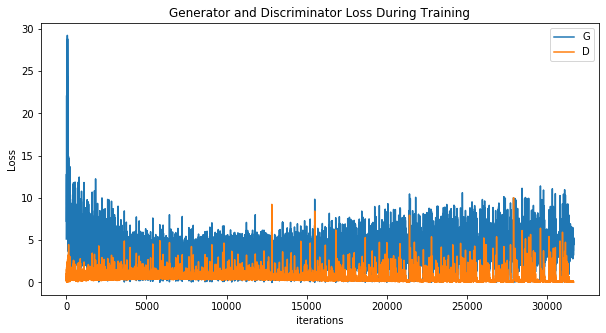

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig("loss/Gen_Dis_loss_Epoch20.jpg")
plt.show()

## View results

Animation size has reached 21246043 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


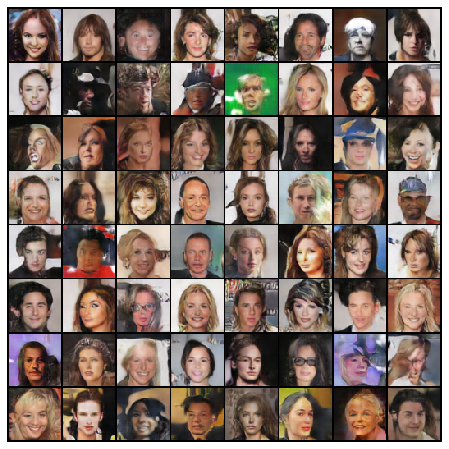

In [12]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(20,20))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.savefig("fake_dcgan_pytorch.jpg")
plt.show()

A grid of Real and Fake images can be found here: ```fake_dcgan_pytorch.jpg```

## Generate Deepfake images using trained model

In [12]:
# Create the generator
netG2 = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG2 = nn.DataParallel(netG2, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG2.apply(weights_init)

netG2.load_state_dict(torch.load("models/dcgan_pytorch_netG_20.pth"))
netG2.eval()

with torch.no_grad():
    fake2 = netG2(fixed_noise).detach().cpu()

/Users/jashrathod/anaconda3/envs/tensorflow_env/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


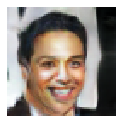

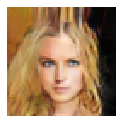

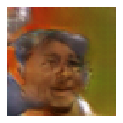

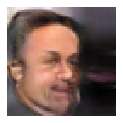

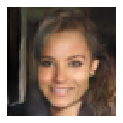

...

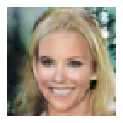

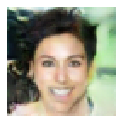

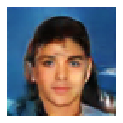

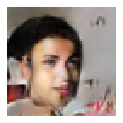

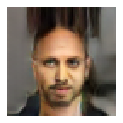

In [13]:
for i in range(64):
    plt.figure(figsize=(2,2))
    plt.axis("off")
#     plt.title("Fake Image")
    plt.imshow(np.transpose(vutils.make_grid(fake2[i], padding=5, normalize=True),(1,2,0)), animated=True)